In [2]:
import numpy as np
import pandas as pd

import scanpy as sc
from collections import Counter
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score, silhouette_score
from tqdm.auto import tqdm

In [2]:
from numba import set_num_threads

set_num_threads(32)

In [5]:
ad_orig = sc.read_h5ad('/data1/chenyx/Adult.Heart.merged.h5ad')

## 1. SCVI

In [6]:
import scvi

Global seed set to 0


In [7]:
method = "scVI"
adata = ad_orig.copy()

### Integration

In [8]:
adata

AnnData object with n_obs × n_vars = 908378 × 43878
    obs: 'cell_ID', 'donor_ID', 'donor_gender', 'donor_age', 'original_name', 'organ', 'region', 'subregion', 'sample_status', 'seq_tech', 'cell_type', 'if_patient', 'donor_status', 'treatment', 'ethnicity', 'Ref', 'MCT', 'develop_stage'
    var: '0'

In [9]:
scvi.model.SCVI.setup_anndata(adata, batch_key="Ref",labels_key="cell_type")

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:78: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/scvi/data/_utils.py:102: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  warnings.warn(


In [10]:
vae = scvi.model.SCVI(adata,n_layers=2, n_latent=30, gene_likelihood="nb")

In [ ]:
vae.train(use_gpu=1)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2]


Epoch 6/9:  56%|█████▌    | 5/9 [20:30:17<16:21:32, 14723.07s/it, loss=4.51e+03, v_num=1]

### calculate umap

In [15]:
adata.obsm["+X_scVI"] = vae.get_latent_representation()

In [16]:
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.leiden(adata)

In [17]:
sc.tl.umap(adata)

### save fig

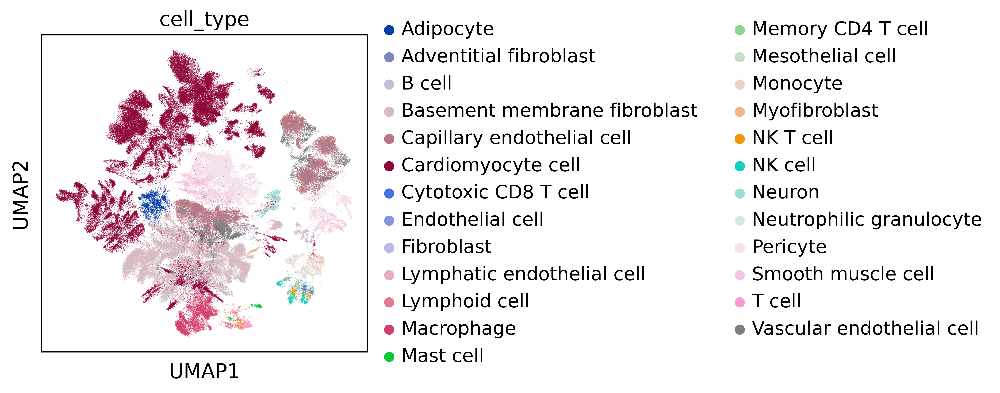

In [21]:
sc.set_figure_params(dpi=300)
sc.pl.embedding(adata, basis='umap', color="cell_type")

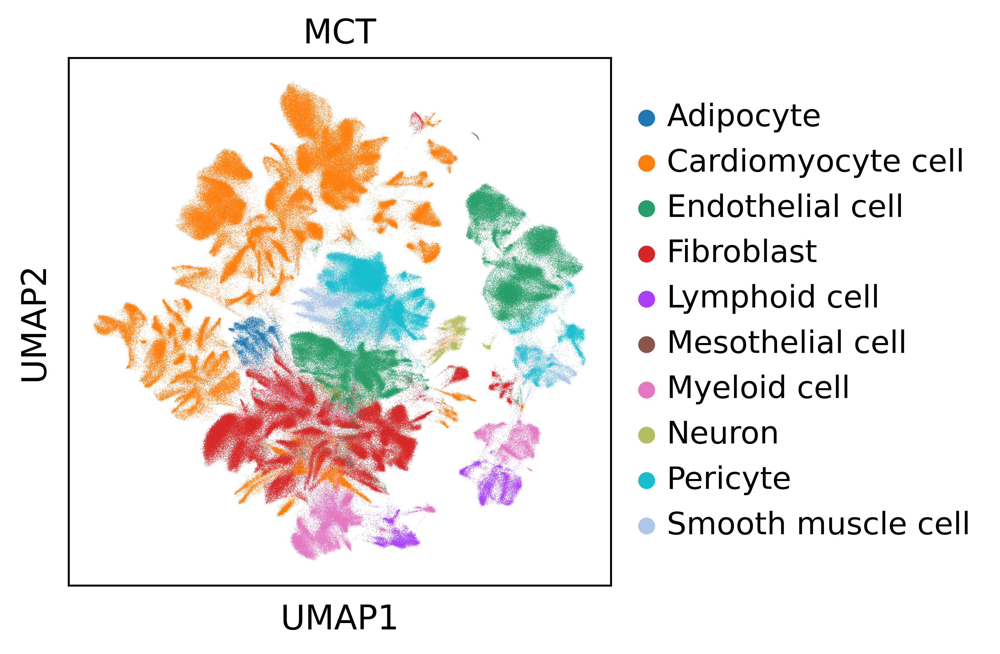

In [22]:
fig = sc.pl.embedding(adata, basis='umap', color="MCT")

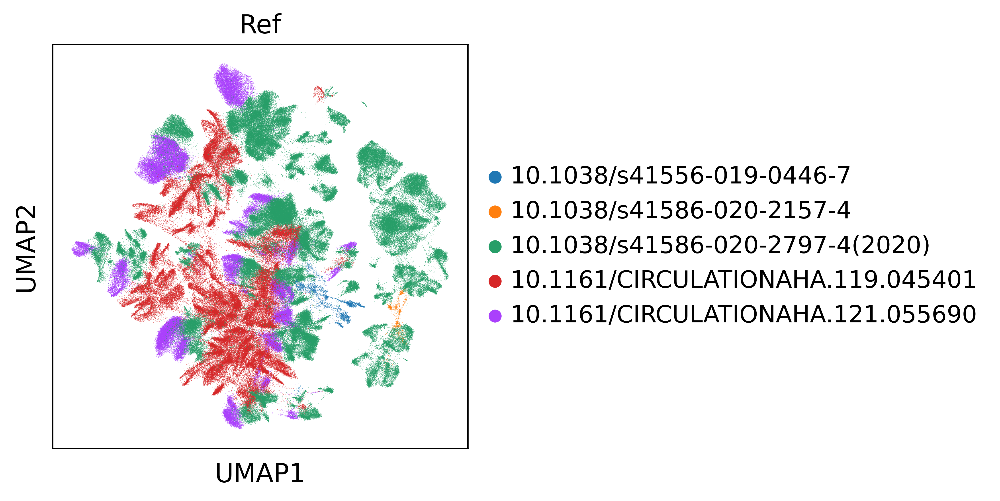

In [23]:
fig = sc.pl.embedding(adata, basis='umap', color="Ref")

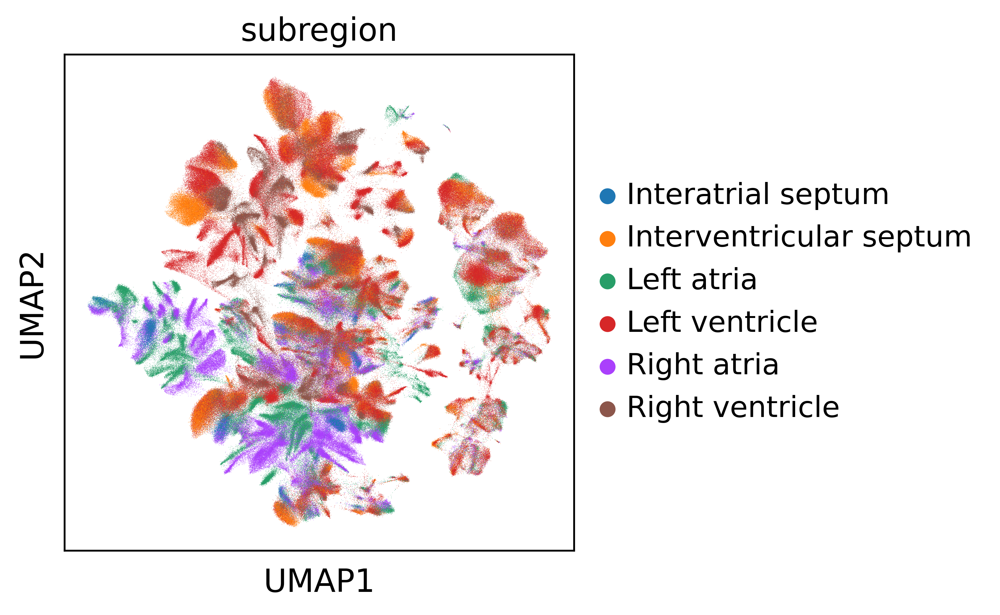

In [24]:
fig = sc.pl.embedding(adata, basis='umap', color="subregion", return_fig=True)

### save coordinates and adata

In [27]:
adata.obsm

AxisArrays with keys: X_scVI, X_umap

In [30]:
print('Saving embedding coordinates...')
adata.obs['UMAP_1'] = adata.obsm['X_' + "umap"][:, 0]
adata.obs['UMAP_2'] = adata.obsm['X_' +  "umap"][:, 1]
coords = adata.obs[["cell_type", "Ref", 'UMAP_1', 'UMAP_2']]
coords.to_csv( "Adult.UMAP.csv", index_label='CellID')

Saving embedding coordinates...


In [31]:
adata.write('/data1/chenyx/processed.scVI.h5ad')

In [32]:
import pickle

In [33]:
pickle.dump(vae, open("scvi.model.adult.pickle","wb"))

## 2. SCANVI

In [35]:
adata = ad_orig.copy()

### Integration

In [42]:
scanvi_model = scvi.model.SCANVI.from_scvi_model(vae, 'Unknown')

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:78: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/scvi/data/_utils.py:102: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  warnings.warn(


In [43]:
scanvi_model.train(25,batch_size=4096, use_gpu=1)

INFO     Training for 25 epochs.                                                             


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2]


Epoch 25/25: 100%|██████████| 25/25 [9:11:12<00:00, 1322.90s/it, loss=4.57e+03, v_num=1]  


In [ ]:
adata.obs["C_scANVI"] = scanvi_model.predict(adata)
adata.obsm["X_scANVI"] = scanvi_model.get_latent_representation(adata)

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/scvi/data/fields/_layer_field.py:78: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/scvi/data/_utils.py:102: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  warnings.warn(


### calculate umap

In [ ]:
sc.pp.neighbors(adata, use_rep="X_scANVI")
sc.tl.umap(adata)

### save fig

In [47]:
method = "SCANVI"

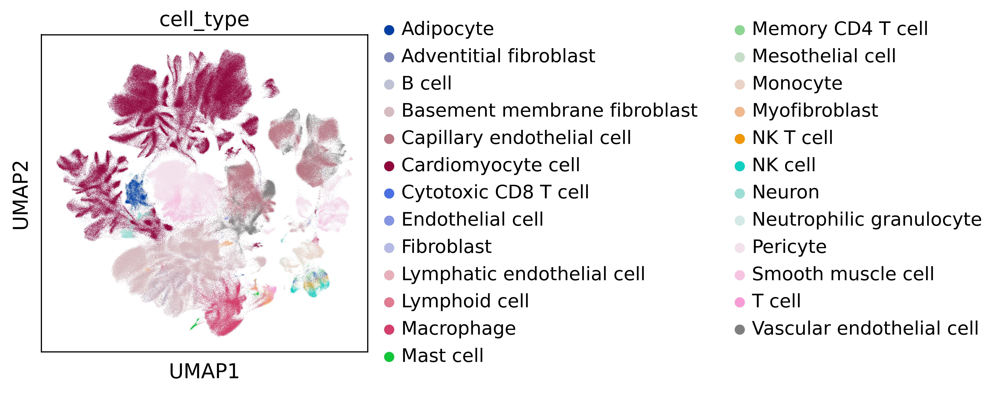

In [48]:
sc.set_figure_params(dpi=300)
fig = sc.pl.embedding(adata, basis='umap', color="cell_type", return_fig=True)

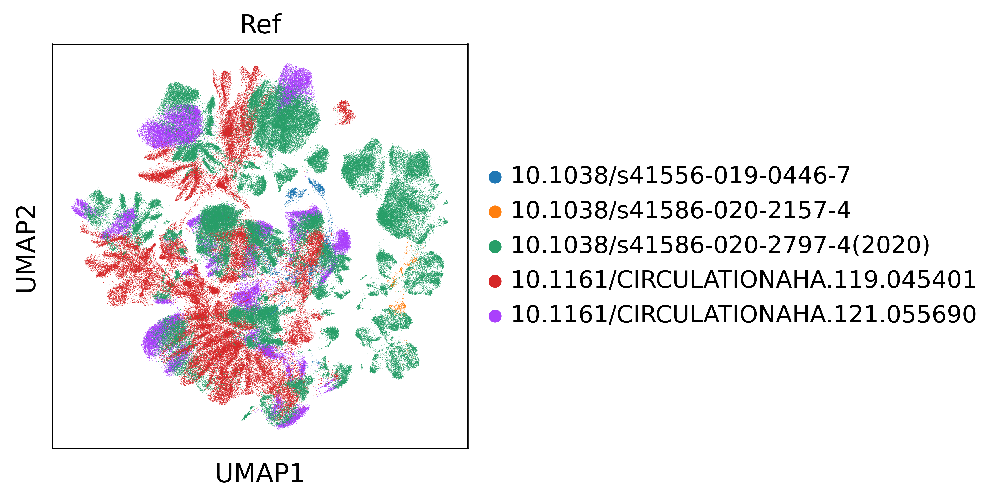

In [49]:
fig = sc.pl.embedding(adata, basis='umap', color="Ref", return_fig=True)

### save coordinates and adata

In [50]:
adata.write('/data1/chenyx/Adult.Heart.SCANVI.h5ad')
del adata

In [3]:
adata = sc.read_h5ad('/data1/chenyx/Adult.Heart.SCANVI.h5ad')

In [4]:
adata

AnnData object with n_obs × n_vars = 908378 × 43878
    obs: 'cell_ID', 'donor_ID', 'donor_gender', 'donor_age', 'original_name', 'organ', 'region', 'subregion', 'sample_status', 'seq_tech', 'cell_type', 'if_patient', 'donor_status', 'treatment', 'ethnicity', 'Ref', 'MCT', 'develop_stage', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: '0'
    uns: 'Ref_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_type_colors', 'neighbors', 'umap'
    obsm: 'X_scANVI', 'X_umap'
    obsp: 'connectivities', 'distances'

In [5]:
import numpy
numpy.array(range(1,10))

array([1, 2, 3, 4, 5, 6, 7, 8, 9])